# Interpretability using SHAP

Main source: https://colab.research.google.com/github/ml6team/quick-tips/blob/main/nlp/2021_04_22_shap_for_huggingface_transformers/explainable_transformers_using_shap.ipynb

Uses the [`shap.Explainer`](https://shap.readthedocs.io/en/latest/generated/shap.Explainer.html) to calculate Shapley values which are used to explain any machine learning model or python function.

One of the differences from the [`shap.DeepExplainer`](https://shap-lrjball.readthedocs.io/en/latest/generated/shap.DeepExplainer.html) is that it does not use any background samples. The `shap.DeepExplainer` is used for deep learning models.

In [ ]:
# !pip install shap

In [1]:
HF_DATASET = 'EvaKlimentova/knots_AF'

## Load the data:

In [2]:
import pandas as pd
from datasets import Dataset, load_dataset

dss = load_dataset(HF_DATASET)
dss = dss['test']
df = pd.DataFrame(dss)
df

Using custom data configuration EvaKlimentova--knots_AF-293560de9ceccb3f
Found cached dataset parquet (/home/jovyan/.cache/huggingface/datasets/EvaKlimentova___parquet/EvaKlimentova--knots_AF-293560de9ceccb3f/0.0.0/2a3b91fbd88a2c90d1dbbb32b460cf621d31bd5b05b934492fdef7d8d6f236ec)


  0%|          | 0/2 [00:00<?, ?it/s]

,ID,latestVersion,globalMetricValue,uniprotStart,uniprotEnd,uniprotSequence,Length,Domain_architecture,InterPro,Max_Topology,Max Freq,Knot Core,label,FamilyName
0,A0A0C1J7Q4,4,80.50,1,501,MIDALSEFHFIRAAWLLLLAPIGLLWWLIRPKPSKQANSASGIAPH...,501.0,PF13519;,IPR011990;IPR019734;IPR002035;IPR036465;,None,NaN,None,0,VIT
1,A0A3D9H7F7,4,95.06,1,168,MQLTHYNSSFKKQKHSITVICDNVTNAPNIGSLFRIADAFGIEQLI...,168.0,PF00588;,IPR029028;IPR004441;IPR001537;IPR029026;,3_1,0.834,"(93, 137)",1,SPOUT
2,A0A1J4RNW5,4,93.69,1,142,MKILAVGKIKESCILEGMHEYLKRMKGRIEIVEIKDSTKEKESIEI...,142.0,PF02590;,IPR029028;IPR003742;IPR029026;,3_1,0.716,"(60, 107)",1,SPOUT
3,A0A7R5L258,4,83.19,1,423,MWGVGGQGVLPALLLLPGLCAGFNIDVENPRVFRGPPESQFGYRVL...,423.0,PF00092;,IPR013519;IPR028994;IPR002035;IPR036465;,None,NaN,None,0,VIT
4,A0A842KII6,4,94.88,1,344,MKVIVYRYGHRIERDKRMTTHVALAARAFGADGIFVDRKDEELEKR...,344.0,PF01966;PF01994;,IPR029028;IPR003607;IPR006674;IPR006675;IPR029...,3_1,0.900,"(79, 121)",1,SPOUT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39407,A0A672HYG6,4,78.62,1,774,SKQPCLCGGNISGCDCVSPSVPLKSIEVELEVRDHVATVVSTLNYQ...,774.0,PF08487;PF13768;,IPR013694;IPR002035;IPR036465;,6_3,0.812,"(60, 622)",1,VIT
39408,A0A1F9XMW4,4,77.31,1,578,MELFRYPVELFWLAAGFAALCIFYFKARAASERVALELMDLRQLIR...,578.0,PF07719;PF13519;,IPR011990;IPR013105;IPR019734;IPR002035;IPR036...,None,NaN,None,0,VIT
39409,A0A2W5N1I1,4,93.44,1,297,MKHFLELSDIPAATLREILDNAHALKKDKYAPPQILEGLSLAMMFD...,297.0,PF00185;PF02729;,IPR006132;IPR006130;IPR036901;IPR006131;IPR002...,None,NaN,None,0,ATCase/OTCase
39410,A0A498S8H6,4,76.50,1,778,MCRDGIIISAASTSLSSVIMYFLALLYCFLGTAIVADVFMCSIEKI...,778.0,PF03160;PF01699;,IPR038081;IPR003644;IPR004836;IPR004837;IPR044...,3_1,0.762,"(41, 678)",1,membrane


## Calculate SHAP for few examples on our M1 model:

In [3]:
import torch
import numpy as np
from transformers import AutoModelForSequenceClassification, AutoTokenizer

def tokenize_function(s):
    return ' '.join(s['uniprotSequence'])

tokenizer = AutoTokenizer.from_pretrained('roa7n/knots_protbertBFD_alphafold')
model = AutoModelForSequenceClassification.from_pretrained('roa7n/knots_protbertBFD_alphafold')

2023-03-30 19:31:39.097567: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-30 19:31:40.498197: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-30 19:31:40.498286: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-30 19:31:40.498294: W tensorfl

[`Pipeline`](https://huggingface.co/docs/transformers/main_classes/pipelines)

== easy way to use models for inference *(`pipeline` is an object that abstract most of the complex code from the library, offering a simple API dedicated to several tasks)*

- can be generic or task-specific, here is used the **generic**

In [4]:
from transformers import TextClassificationPipeline

# https://huggingface.co/transformers/v3.0.2/main_classes/pipelines.html can be put to CUDA!!!!!!!!!!!!!!!!! :)))))
pipe = TextClassificationPipeline(model=model, tokenizer=tokenizer, top_k=None, device=0)
pipe

**[`shap.plots.text`](https://shap.readthedocs.io/en/latest/example_notebooks/api_examples/plots/text.html)** 

**Single instance plot** - the importance of each token overlayed on the original text that corresponds to that toke.

- red regions == parts of the text that increase the output of the model when they are included

- blue regions == decrease the output of the model when they are included

If `.hierarchical_values` attribute: small groups of tokens with strong non-linear effects among them are auto-merged together + the explainer may not have completely enumerated all possible token perturbations => it has treated chunks of the text as essentially a single unit. 

**Multiple instance text plot** - single instance plots for each input instance scaled so they have consistent comparable x-axis and color ranges.

**[`shap.plots.text`](https://shap.readthedocs.io/en/latest/example_notebooks/api_examples/plots/text.html)** 

**Single instance plot** - the importance of each token overlayed on the original text that corresponds to that toke.

- red regions == parts of the text that increase the output of the model when they are included

- blue regions == decrease the output of the model when they are included

If `.hierarchical_values` attribute: small groups of tokens with strong non-linear effects among them are auto-merged together + the explainer may not have completely enumerated all possible token perturbations => it has treated chunks of the text as essentially a single unit. 

**Multiple instance text plot** - single instance plots for each input instance scaled so they have consistent comparable x-axis and color ranges.

In [5]:
import shap
from datetime import datetime

def score_and_visualize(text):
    prediction = pipe([text])
    print(prediction[0])
    explainer = shap.Explainer(pipe)
    
    # calculate SHAP values:
    start = datetime.now()
    print(f'-- Started calculating SHAP values at {start.strftime("%H:%M:%S")}.')
    shap_values = explainer([text])
    end = datetime.now()
    print(f'-- Done at {end.strftime("%H:%M:%S")} (took {end - start}).')
    
    shap.plots.text(shap_values)
    return shap_values

Helper function for visualising overlap of SHAP values with the knot core position:

In [6]:
import matplotlib.pyplot as plt


def plot_scores_vs_core(shap_values, seq_info):
    # plot SHAP values:
    main_class = np.argmax(shap_values.base_values[0].tolist())      # check if predicted class was 0 or 1
    scores = [b for a,b in shap_values.values[main_class].tolist()]  # display scores only for the main class
    plt.plot([_ for _ in range(len(scores))], scores)
    
    # plot knot core:
    if seq_info['Knot Core']:
        knot_start, knot_end = [int(_) for _ in seq_info['Knot Core'].replace('(', '').replace(')', '').replace(',', '').split()]
        seq_len = len(seq_info['uniprotSequence'])
        knot_scores = [max(scores) if _ >= knot_start and _ <= knot_end else 0.0 for _ in range(seq_len)]
        plt.plot([_ for _ in range(seq_len)], knot_scores)
    plt.show()

----> START 19:31:48.

i=0, MIDALSEFHFIRAAWLLLLAPIGLLWWLIRPKPSKQANSASGIAPHLAEALQLGADDTRRIYPIDVAMIAAILIALAAAGPTWSRSPNPLVADTAPLVIALKVTDSMEEADLPPSRLERAKFKITDLINARADARTALIAYAGTPHRVAPLTEDANILRPLLEGLTPAVMPKPGDAASDALSVAETILSDSETPGAILFVLDDIDPSQVPGIEAATAPVFVLTMRPNGERVAQLDGLGNTTVVPFSEDDRDIARLQRVIHSAYSAALDDDDRLDWQDRGWILAWPAALLSLLWFRKGWVIRWAFLALLLIPPSGPAFAGGWRDWFLTPDQQGQIAMNQKRYADAADLFKDPYHKGYAHLKAGQYPEAAAIFAELDTPDAAFAEGMARIRNREYRPAISAFETALERQPDWPEAQHNLEVANAILAFVETTREQSDTGEEAGIGADDTVFDNEAGRGEDTTVQAPTDGAQALSADQWISTIDTDMQDFLRNRFLLENQEQQQ (501.0)
[{'label': 'LABEL_0', 'score': 0.9998502731323242}, {'label': 'LABEL_1', 'score': 0.0001496698969276622}]
-- Started calculating SHAP values at 19:31:48.


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:32, 32.27s/it]               

-- Done at 19:32:21 (took 0:00:32.275442).


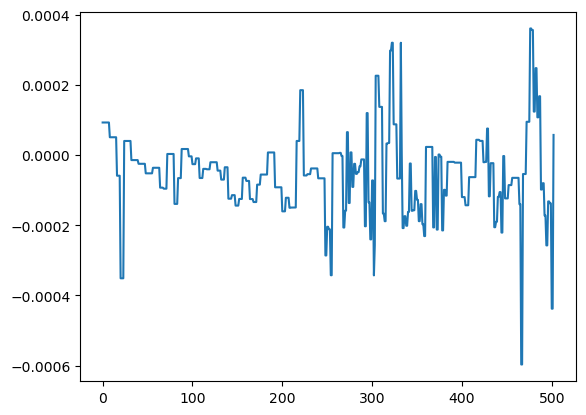


i=1, MQLTHYNSSFKKQKHSITVICDNVTNAPNIGSLFRIADAFGIEQLIFCGSDIPLGKRMTKTSRSTEKYVNHSVEEDIESRIEILKASGFYLIALEITEKSQSLSEFKLQTNQPIALILGDENFGISDTILNQADAIIHINMYGNNSSMNVVQATGIALYEITKQLNAD (168.0)
[{'label': 'LABEL_1', 'score': 0.9998354911804199}, {'label': 'LABEL_0', 'score': 0.000164427183335647}]
-- Started calculating SHAP values at 19:32:21.


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:12, 12.89s/it]               

-- Done at 19:32:34 (took 0:00:12.895815).


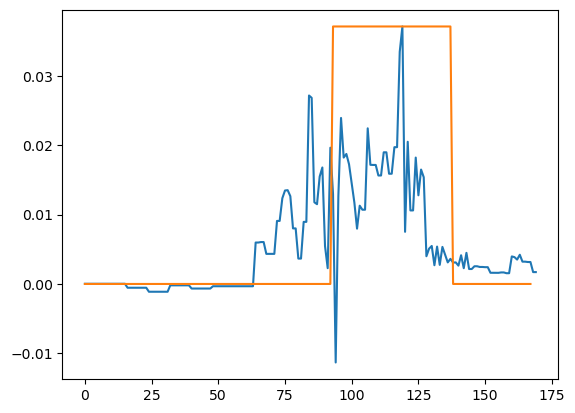


i=2, MKILAVGKIKESCILEGMHEYLKRMKGRIEIVEIKDSTKEKESIEITRKLEKLDRFLTVALDEHGKEMTSLEFSEFIKNNFNKNLCFIVGGPDGLDKSILEGVDHTLALSRMTFTHEMARLLLVEQLYRAFSIIDGKKYHRG (142.0)
[{'label': 'LABEL_1', 'score': 0.9998468160629272}, {'label': 'LABEL_0', 'score': 0.00015317369252443314}]
-- Started calculating SHAP values at 19:32:34.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:11, 11.25s/it]               

-- Done at 19:32:45 (took 0:00:11.256225).


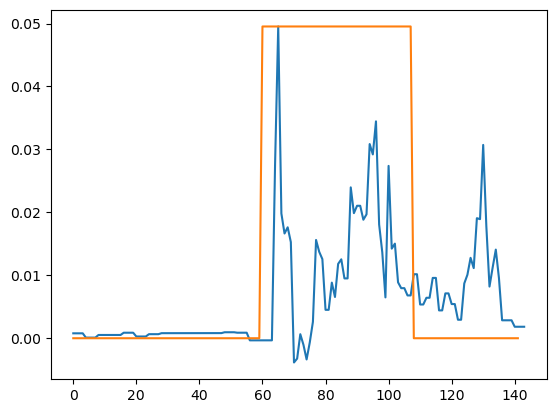


i=3, MWGVGGQGVLPALLLLPGLCAGFNIDVENPRVFRGPPESQFGYRVLQWGGDGDRGLLVGAPWDGDGQGDVYKCGVGPQNSSCAKANLGDTAPWLRGSAGHLGMTLVGSKDGGFVACAPLWSQECGTSVFSSGRCVRLDEELRLVETVAPTAQRCSTYMDIVLVLDGSNSIYPWEEVQDFLGNILGRFFIGPGQTQVGVLQYGEEVVQEWALGQHPTAQALLEAARNLTRQEGRETRTAMAIRQACAESFSAERGGRSGAARLLLVVTDGESHDGEELPAALAECEKRNITRYAIAVLGHYLRRQQDPEDFIREIKFIASDPDEKYFFNVTDEAALNDIVDALGDRIFSLEGTREDNESAFELEMSQIGFSIHLLEDGILFGMVGAYDWEGGVLEESRRGRIIPPREAFQGEFPLELKNHAAYL (423.0)
[{'label': 'LABEL_0', 'score': 0.9997437596321106}, {'label': 'LABEL_1', 'score': 0.0002562174340710044}]
-- Started calculating SHAP values at 19:32:45.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:27, 27.30s/it]               

-- Done at 19:33:13 (took 0:00:27.305990).


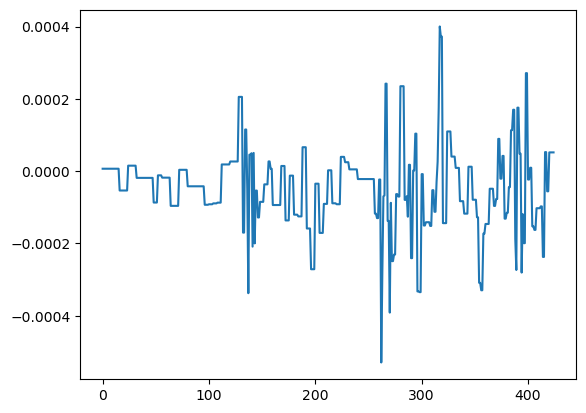


i=4, MKVIVYRYGHRIERDKRMTTHVALAARAFGADGIFVDRKDEELEKRIRKVIERFGGNFFIESGIDWKKLIKEWNGKIIHLTMYGEKIENVIEEIKKFENILVIVGSEKVPGEFYEISDYNVAIGNQPHSEVSSIAIFLHMLNGGEWMKRNFGGVIKIIPSKKGKKLSYNYLKILEKEGCSKDVIEHCKKVRDLAIKIAEKIAENGINLDMEAIEAGAILHDVGRAKRNDLMHVVEGVKIAKKYGLPKKVVAIIERHVGSGIDEEDAERLGLPKKDYIPKSIEEEIVSHADNLTSNGYRNIEEAINEFKKFGDKQVKKLIETHEKLSKFAGLDIDRIVDGLKPSK (344.0)
[{'label': 'LABEL_1', 'score': 0.9997729659080505}, {'label': 'LABEL_0', 'score': 0.00022699963301420212}]
-- Started calculating SHAP values at 19:33:13.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:22, 22.49s/it]               

-- Done at 19:33:35 (took 0:00:22.493370).


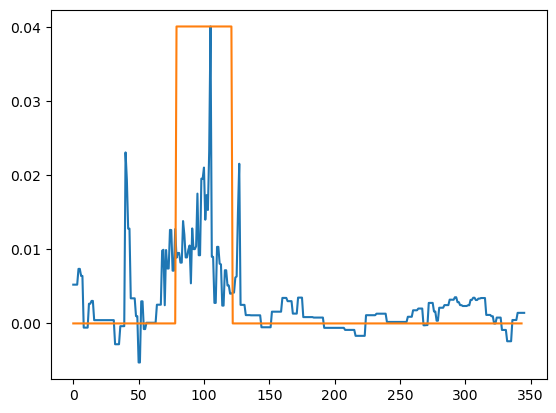


i=5, MEFSIIIDCVIVFASIIMLWKGADWLVDSAAEIAHTLKISDLVVGLTVVAFGTSAPEFAVTISAAITKQTDISIGNVIGSNIFNLGFILGGTAMIRPIATNKKMFERDGLFLLITTALIFFLFFGFDGWTAGDSFTQYEGVLLFSLLIAYVAFLFIKKDPPEEVNPDSATLESYAFFLIGLVMIVAGGHLMVEHASNVARYLGVSDWVIAVTIVAAGTSAPEFATSVAAALKGRHGIAIGNLIGSDLFNLLGVLGLAGIINPTMISEDIFSSVFLLVIMVGLTLLMIRTNWRLSRAEGTILVTINLIRWYFDFAGS (316.0)
[{'label': 'LABEL_1', 'score': 0.9998714923858643}, {'label': 'LABEL_0', 'score': 0.00012853389489464462}]
-- Started calculating SHAP values at 19:33:36.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:20, 20.62s/it]               

-- Done at 19:33:56 (took 0:00:20.619955).


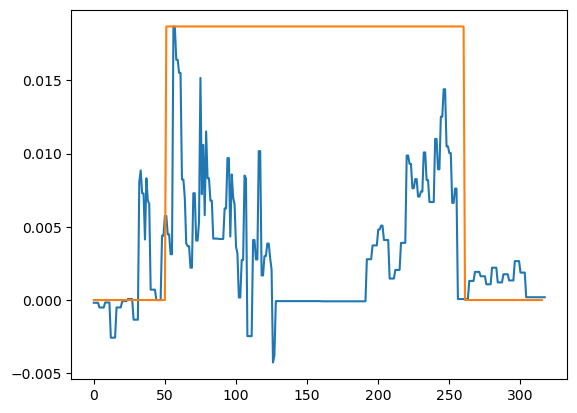


i=6, MSFLDQRSNATVISVKPANSTVREFILFSRTARTDSNFTSLMDGGRLDVVYQCILMSIFSSHKHRDTKFHGILNGSPNPPLHLEVDGRELRDARVDEKTWEDILRKVLSGEAHPGIKLEKKSFQELVKEKGKVYVLEEKGMDISKVKFDKNPVFVLGDQVGLPKKDEKFALRYGEKVSLGKGLYLSSSSIDIVNWWLDRKGIQ (203.0)
[{'label': 'LABEL_1', 'score': 0.9996739625930786}, {'label': 'LABEL_0', 'score': 0.00032610545167699456}]
-- Started calculating SHAP values at 19:33:56.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:15, 15.75s/it]               

-- Done at 19:34:12 (took 0:00:15.753865).


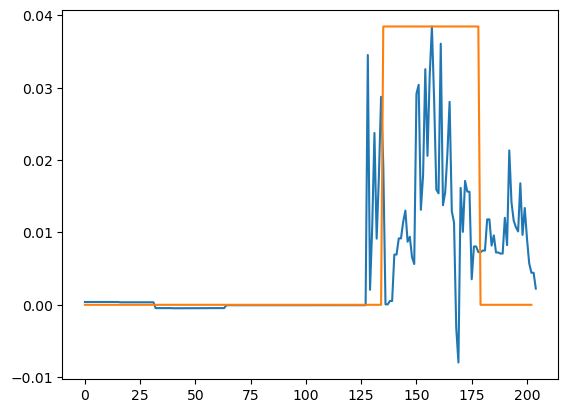


i=7, ALEKNYDTEWLEKKIPEILSILEIDALVTIPLATPWKGPGLLVTPEDLLKAMQKIAKNRESDFGKIDVKNIMSGKAVAEEFKVIKEENRKNENKGLGNETIGIQVPGSTNVDETRIYDQDLISNLKTRFKDWKTSWSEQHVPSGDEFDEESYIEGHLPFLTDIKKSIKAKIVILVDHSSSITDQQTQYKKVTVALCEVLSFLKIKFSVYAFNTTQKQVVCWLVKPEDMKWNNACAKRLAQIDANGGTPLADVYQKMYPILRSKKPDIFLTLSDGEPSDPDAVRAMVKSLKTVGIKMVAIGVGRDTFGATQIANNLKYLEYERTLAVSRLKDIPNRVLAVLQTS (343.0)
[{'label': 'LABEL_0', 'score': 0.9998903274536133}, {'label': 'LABEL_1', 'score': 0.00010966366244247183}]
-- Started calculating SHAP values at 19:34:12.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:22, 22.59s/it]               

-- Done at 19:34:35 (took 0:00:22.588618).


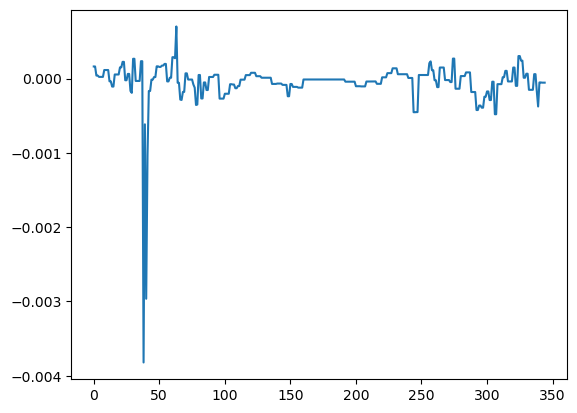


i=8, MFRFGAEHWLYGLLLIPLLGLFFIYAFRSKRKAMAIFGNPKLMAILAGSVSSNRRVWKTILVLLSVGLMILALARPQWGTKMRTVKREGQDIFIALDVSTSMLAEDIKPNRLEKAKHAIASLIDQFRGDRVGLIAFSGKAFVQCPLTLDYGAVKMFLDAMDPEMIPVPGTAIEEAILKAIESFSKTERKHKVLILITDGEDHGGDPLKAAKSAANEGVVIYTVGIGTPEGVPIPIKDERGNPIGFKKTREGEVVMTKLDEITLEKIALETGGKYYRATPGEMELKKIYDDILKMEKKTLESREFEQYEERFQGLVGIALFCLALELFISDRRKIKREWKGRFET (344.0)
[{'label': 'LABEL_0', 'score': 0.9998651742935181}, {'label': 'LABEL_1', 'score': 0.00013479003973770887}]
-- Started calculating SHAP values at 19:34:35.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:22, 22.60s/it]               

-- Done at 19:34:58 (took 0:00:22.606544).


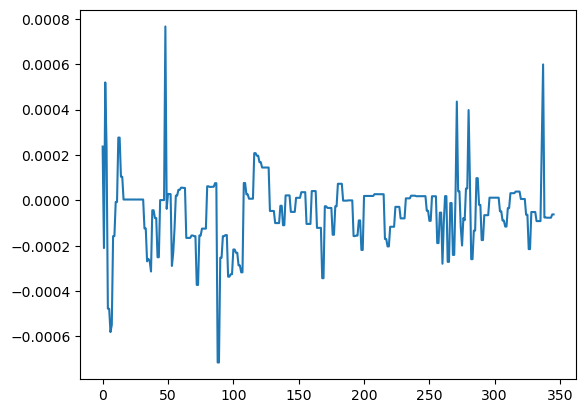


i=9, MSTPAKAPLTRQQVVDRAAELGIAATRLRFFDEETLASSAKDLHDYTQLTDVALRSIREPAEGLFIAESSKIIRRAHAAGMVPRSYLTSPKWLFDLADIIAANDAPIHIGTDAAVESLTGFHLHRGALAAMHRPQALDVAQLVSDARRIIVIEDVVDHTNVGAIFRSAAAFGVDAVLVTPRCADPLYRRSIRVSMGTVFQVPWTRIESWPAGVDSLRELGFHIAALALDEDSVAIREFAADAPERTAIVFGTEGDGLRRSTIAACDSTVMIPMSGGVDSLNVAAASAVACFALQID (296.0)
[{'label': 'LABEL_1', 'score': 0.9998437166213989}, {'label': 'LABEL_0', 'score': 0.00015620114572811872}]
-- Started calculating SHAP values at 19:34:58.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:20, 20.09s/it]               

-- Done at 19:35:18 (took 0:00:20.091614).


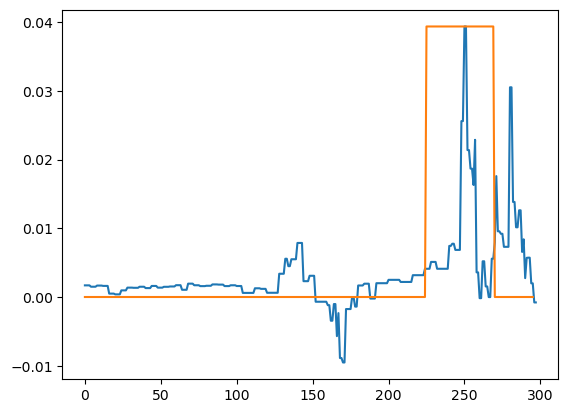


i=10, MTFQPVLPPLLLAAVAVIVVVARVVALRRLSPAARTRGALWRWGGLTAAALLLVVSAARPVLDPADPDTRVADSQAPNVFVVVDRSPDMDVRDGPDGASRMAAARTDVAAVLDRYPDARVALISFASRASLDWPLSADTWSLRPVVSTLTPYAAGPDAASETNAGAAGNMLRYQLISAVQQYPRARNLVFYLGAGAPEAALPPRDFNLPENAVDGGAVLGYGSLAGGPVPGTDVTRSAVDEATLRGVADQIGVPYALRSGADGLDSVLPAEPAEPADQTTAGGGNASRTELYWAPAALAALLVLVELYHVLREFRRTRQTMTDVSV (326.0)
[{'label': 'LABEL_0', 'score': 0.9998565912246704}, {'label': 'LABEL_1', 'score': 0.00014339476183522493}]
-- Started calculating SHAP values at 19:35:18.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:22, 22.03s/it]               

-- Done at 19:35:40 (took 0:00:22.030672).


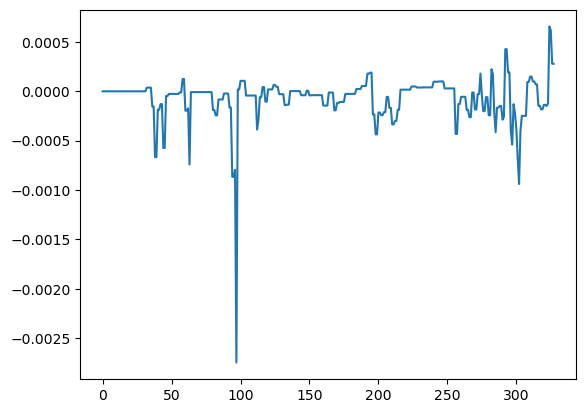


i=11, MVAVVLLVAAVGLWIWLGNRSASENRTAAGQCIEGPVTLAVTVDPEIAGPVRAAADRYNATVPQVRDHCAKVAVTVQPTAAMVAALTAPNWDAKLGPQPGLWIPSSSRAVERMRVPGLVQGTPASVASSPIVVAVPEQLGQALDKAKPSWSDLPRLQRGSLADLGLGSWNGLRMALPPGDTSLAAAVAVGSAVSGSDPLTEDSARSGQVVAAISGLAAEAPEAADTAAALAAVAQRGQTADGPIHAVAVTEQQAKAYPHLAQLRPTGAAPVDDYPAALLTGSWVDKTQNLVAGLFADYLRAPAQQKLFTDNGFEAPAATPVAPPAKSVLDQVQSVLANPVLGVQSTILIDTSASMASTDGSMSRLNNTLAAVQSTLDTMPPDFGAGAWIYANQLADGNPYRMIARTAPLSPQHRRELSTALGNVALAGSSTDRTYPALEAAYRSAVENYATGKTNSVLLITGGPNDSSSVTGDQLLADITGATDAAHPVRVDVIVVGGQGAPTLQNLAQKTGGTYTKVATSDDMSFGTAVNHALTTT (537.0)
[{'label': 'LABEL_0', 'score': 0.9998773336410522}, {'label': 'LABEL_1', 'score': 0.00012267657439224422}]
-- Started calculating SHAP values at 19:35:41.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:35, 35.03s/it]               

-- Done at 19:36:16 (took 0:00:35.030008).


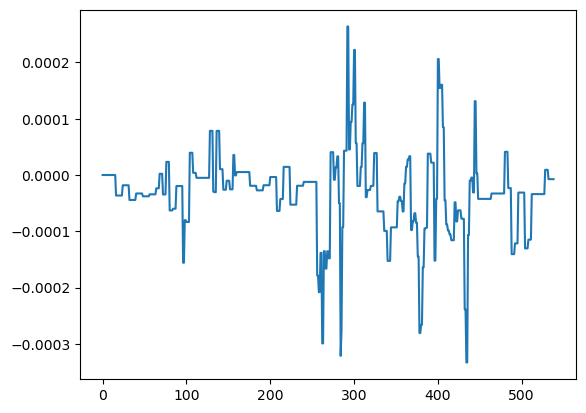


i=12, MTSGPQSIHSRDNALLKELRRLAQDSTAYRKQGRVWLEGDHLCRAALQRGQHPALAVFQASWYDQVGHQWDDAGGKVVVIEDGLFATLSALESPGRMGFVLPLPQASTLDAQAPTVVLDGLQDAGNVGTILRSAAAFGFRQVLAMKGTAALWSPKVLRAGMGAHFGLKLIEGLEPAALDALRIPLLATSSHQGDYLHQATLPWPCGWVLGHEGQGVSTALAARAAQFLRIVQPGGEESLNVGAAAAICLHASAAGQAGNMDAGFAASS (268.0)
[{'label': 'LABEL_1', 'score': 0.9997645020484924}, {'label': 'LABEL_0', 'score': 0.00023551996855530888}]
-- Started calculating SHAP values at 19:36:16.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:18, 18.92s/it]               

-- Done at 19:36:35 (took 0:00:18.916973).


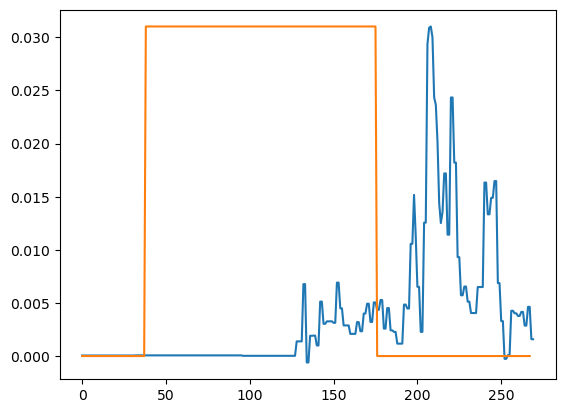


i=13, MQFHLAASVLVPPTTALDTVRARLDDLAARPDAYLAAGTRIDLGLAAARDVLAAHPRPAARPIVVVLTDGVLPESLYEAALEVARDAREGHGAAIYTVGLGTLFDARLLEAVAGRPERFAPVVEPAALAGVMRGMAQAAVCEDDGGAP (148.0)
[{'label': 'LABEL_0', 'score': 0.9998152852058411}, {'label': 'LABEL_1', 'score': 0.00018473132513463497}]
-- Started calculating SHAP values at 19:36:35.


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:11, 11.84s/it]               

-- Done at 19:36:47 (took 0:00:11.836179).


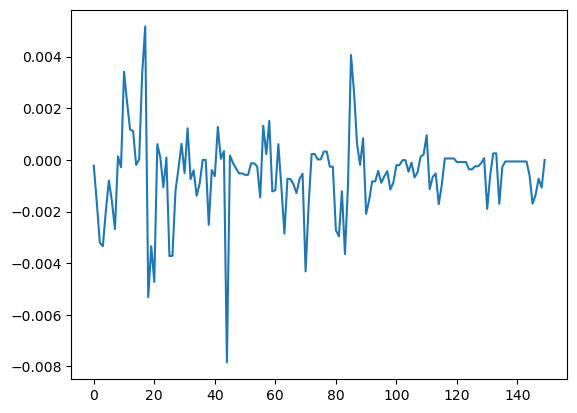


i=14, EDLLLRLLLLLFLELLWLVRDAEMTCMRTVAAAHLLLAVLLAASVGVGATSASKVKLVNNGYEGVVIGISPEVSERDAPALITVLKTMMRNASKHLFQATRRRAFFRQVKVVIPQTWSNTAYDEAATNENFMDSDIRLDYPHPLYKNQMYTEQPGECGEPGEYIHLTPAYLTVDKYSKWFGSPGKTLVTEWARLRWGVFDEVGYPGDPKYPLFYSASSSGASGRVDAASEEYSPNCCSDAPIKGIKRNKRPGGGITCILGPDNLPDHFCKFYPHHSQNARSSLMSYPFIPSFNIVEFCDSHTHVPFAPTKQNDKCNYRSVWEVMLDHPDFKDGANPPISGEPDEPSIAVVKQEAASYAVVMDYSGSMSTNNRIEMLQKTAQRWLLHEAPHNSLVSLIRFSSSPARVLAPLTKLTDNTTRQALANMILTDTTGATSIGSGMRAAVQVLAGKSNKNMLLITDGEENESPRINDVIEEVIQARICVITVAFGTNADPNLETVADRTGCKAYTVNDNDQSSMLNDAFQSTLTRQPSIALQFTDILIYESPTKYTTDSSVSDTFTVDSSVGKNLIFRLQTSSKNHVVSPPRLIDPDGSVTSVTDFDDISLVWSVTLPEAKVGTWTWEASLDKDKFNSVKVSITARQRDPNAPPITTRVWVPSPATGVSAVTQNIKIFAEVKQGNNPIIGAVVKAIVTQPDTITAPPDEYLLSDNGVGADSIKNDGIYSGFMTKFSAVGRYNVKAEVTSTGKTVANNGAAPSGSSGRRRRRSTSSANYDQGEPEPCCGSVMPLDEANASPTGNFSRVATGGVLKVTEIPAAGTDGISPVKVDDLQVISITMFSESLGANTITLSWTAPGDDLDSGIASAYVVRLSPNFHDLLEGSFDQAPQDTLLPVTVEDLHSANVFRESGSKVNITLKFTRRIAYDQPYYVGLQALDETGNKSKVSNIVMFTVEEKLEMPQWALDKMQKIRMDTASFKNLKTKSIPQTLNE (987.

  0%|          | 0/498 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [7]:
def loop_over_samples(index_start, index_end):
    start = datetime.now()
    print(f'----> START {start.strftime("%H:%M:%S")}.\n')

    for i in range(index_start, index_end):
        sample = df.iloc[i]
        print(f'i={i}, {sample["uniprotSequence"]} ({sample["Length"]})')
        shap_values = score_and_visualize(tokenize_function(sample))
        plot_scores_vs_core(shap_values, sample)
        print()

    end = datetime.now()
    print(f'\n----> END {end.strftime("%H:%M:%S")} (took {end - start}).')
    
loop_over_samples(0, 7)

----> START 19:37:49.

i=7, ALEKNYDTEWLEKKIPEILSILEIDALVTIPLATPWKGPGLLVTPEDLLKAMQKIAKNRESDFGKIDVKNIMSGKAVAEEFKVIKEENRKNENKGLGNETIGIQVPGSTNVDETRIYDQDLISNLKTRFKDWKTSWSEQHVPSGDEFDEESYIEGHLPFLTDIKKSIKAKIVILVDHSSSITDQQTQYKKVTVALCEVLSFLKIKFSVYAFNTTQKQVVCWLVKPEDMKWNNACAKRLAQIDANGGTPLADVYQKMYPILRSKKPDIFLTLSDGEPSDPDAVRAMVKSLKTVGIKMVAIGVGRDTFGATQIANNLKYLEYERTLAVSRLKDIPNRVLAVLQTS (343.0)
[{'label': 'LABEL_0', 'score': 0.9998903274536133}, {'label': 'LABEL_1', 'score': 0.00010966366244247183}]
-- Started calculating SHAP values at 19:37:49.


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:22, 22.50s/it]               

-- Done at 19:38:11 (took 0:00:22.503290).


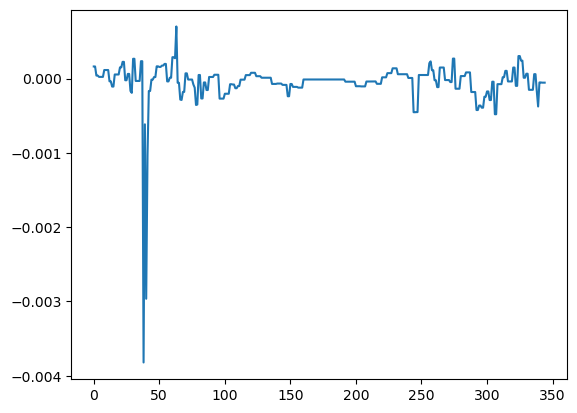


i=8, MFRFGAEHWLYGLLLIPLLGLFFIYAFRSKRKAMAIFGNPKLMAILAGSVSSNRRVWKTILVLLSVGLMILALARPQWGTKMRTVKREGQDIFIALDVSTSMLAEDIKPNRLEKAKHAIASLIDQFRGDRVGLIAFSGKAFVQCPLTLDYGAVKMFLDAMDPEMIPVPGTAIEEAILKAIESFSKTERKHKVLILITDGEDHGGDPLKAAKSAANEGVVIYTVGIGTPEGVPIPIKDERGNPIGFKKTREGEVVMTKLDEITLEKIALETGGKYYRATPGEMELKKIYDDILKMEKKTLESREFEQYEERFQGLVGIALFCLALELFISDRRKIKREWKGRFET (344.0)
[{'label': 'LABEL_0', 'score': 0.9998651742935181}, {'label': 'LABEL_1', 'score': 0.00013479003973770887}]
-- Started calculating SHAP values at 19:38:11.


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:22, 22.60s/it]               

-- Done at 19:38:34 (took 0:00:22.598297).


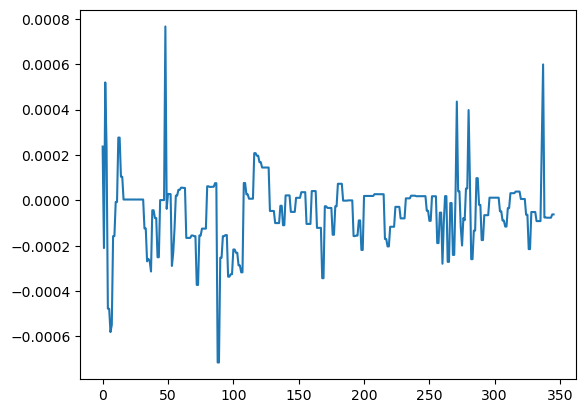


i=9, MSTPAKAPLTRQQVVDRAAELGIAATRLRFFDEETLASSAKDLHDYTQLTDVALRSIREPAEGLFIAESSKIIRRAHAAGMVPRSYLTSPKWLFDLADIIAANDAPIHIGTDAAVESLTGFHLHRGALAAMHRPQALDVAQLVSDARRIIVIEDVVDHTNVGAIFRSAAAFGVDAVLVTPRCADPLYRRSIRVSMGTVFQVPWTRIESWPAGVDSLRELGFHIAALALDEDSVAIREFAADAPERTAIVFGTEGDGLRRSTIAACDSTVMIPMSGGVDSLNVAAASAVACFALQID (296.0)
[{'label': 'LABEL_1', 'score': 0.9998437166213989}, {'label': 'LABEL_0', 'score': 0.00015620114572811872}]
-- Started calculating SHAP values at 19:38:34.


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:20, 20.10s/it]               

-- Done at 19:38:54 (took 0:00:20.102592).


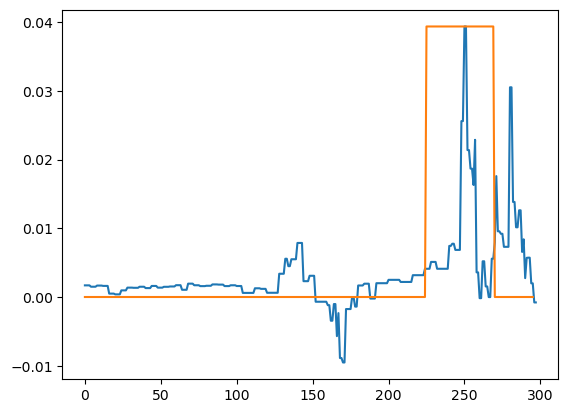


i=10, MTFQPVLPPLLLAAVAVIVVVARVVALRRLSPAARTRGALWRWGGLTAAALLLVVSAARPVLDPADPDTRVADSQAPNVFVVVDRSPDMDVRDGPDGASRMAAARTDVAAVLDRYPDARVALISFASRASLDWPLSADTWSLRPVVSTLTPYAAGPDAASETNAGAAGNMLRYQLISAVQQYPRARNLVFYLGAGAPEAALPPRDFNLPENAVDGGAVLGYGSLAGGPVPGTDVTRSAVDEATLRGVADQIGVPYALRSGADGLDSVLPAEPAEPADQTTAGGGNASRTELYWAPAALAALLVLVELYHVLREFRRTRQTMTDVSV (326.0)
[{'label': 'LABEL_0', 'score': 0.9998565912246704}, {'label': 'LABEL_1', 'score': 0.00014339476183522493}]
-- Started calculating SHAP values at 19:38:55.


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:22, 22.02s/it]               

-- Done at 19:39:17 (took 0:00:22.021158).


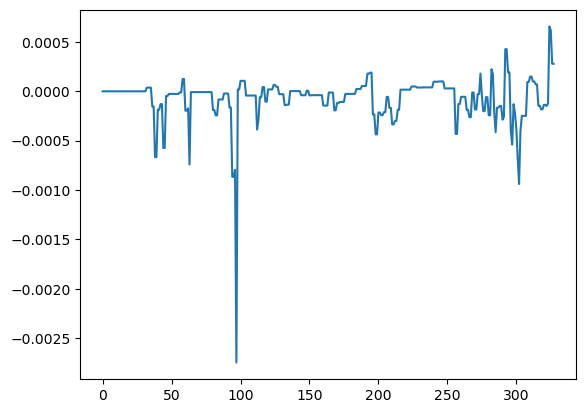


i=11, MVAVVLLVAAVGLWIWLGNRSASENRTAAGQCIEGPVTLAVTVDPEIAGPVRAAADRYNATVPQVRDHCAKVAVTVQPTAAMVAALTAPNWDAKLGPQPGLWIPSSSRAVERMRVPGLVQGTPASVASSPIVVAVPEQLGQALDKAKPSWSDLPRLQRGSLADLGLGSWNGLRMALPPGDTSLAAAVAVGSAVSGSDPLTEDSARSGQVVAAISGLAAEAPEAADTAAALAAVAQRGQTADGPIHAVAVTEQQAKAYPHLAQLRPTGAAPVDDYPAALLTGSWVDKTQNLVAGLFADYLRAPAQQKLFTDNGFEAPAATPVAPPAKSVLDQVQSVLANPVLGVQSTILIDTSASMASTDGSMSRLNNTLAAVQSTLDTMPPDFGAGAWIYANQLADGNPYRMIARTAPLSPQHRRELSTALGNVALAGSSTDRTYPALEAAYRSAVENYATGKTNSVLLITGGPNDSSSVTGDQLLADITGATDAAHPVRVDVIVVGGQGAPTLQNLAQKTGGTYTKVATSDDMSFGTAVNHALTTT (537.0)
[{'label': 'LABEL_0', 'score': 0.9998773336410522}, {'label': 'LABEL_1', 'score': 0.00012267657439224422}]
-- Started calculating SHAP values at 19:39:17.


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:34, 34.97s/it]               

-- Done at 19:39:52 (took 0:00:34.976020).


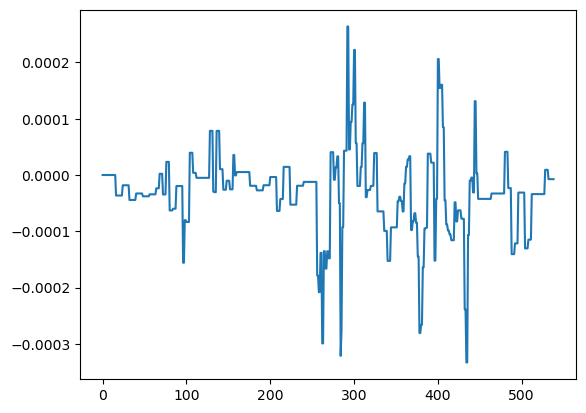


i=12, MTSGPQSIHSRDNALLKELRRLAQDSTAYRKQGRVWLEGDHLCRAALQRGQHPALAVFQASWYDQVGHQWDDAGGKVVVIEDGLFATLSALESPGRMGFVLPLPQASTLDAQAPTVVLDGLQDAGNVGTILRSAAAFGFRQVLAMKGTAALWSPKVLRAGMGAHFGLKLIEGLEPAALDALRIPLLATSSHQGDYLHQATLPWPCGWVLGHEGQGVSTALAARAAQFLRIVQPGGEESLNVGAAAAICLHASAAGQAGNMDAGFAASS (268.0)
[{'label': 'LABEL_1', 'score': 0.9997645020484924}, {'label': 'LABEL_0', 'score': 0.00023551996855530888}]
-- Started calculating SHAP values at 19:39:52.


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:18, 18.90s/it]               

-- Done at 19:40:11 (took 0:00:18.899684).


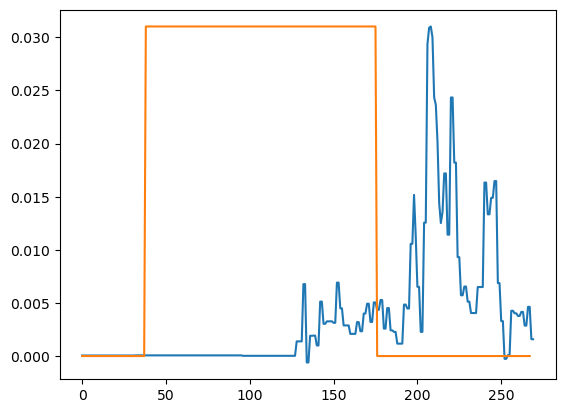


i=13, MQFHLAASVLVPPTTALDTVRARLDDLAARPDAYLAAGTRIDLGLAAARDVLAAHPRPAARPIVVVLTDGVLPESLYEAALEVARDAREGHGAAIYTVGLGTLFDARLLEAVAGRPERFAPVVEPAALAGVMRGMAQAAVCEDDGGAP (148.0)
[{'label': 'LABEL_0', 'score': 0.9998152852058411}, {'label': 'LABEL_1', 'score': 0.00018473132513463497}]
-- Started calculating SHAP values at 19:40:11.


  0%|          | 0/498 [00:00<?, ?it/s]


Partition explainer: 2it [00:11, 11.63s/it]               

-- Done at 19:40:23 (took 0:00:11.634991).


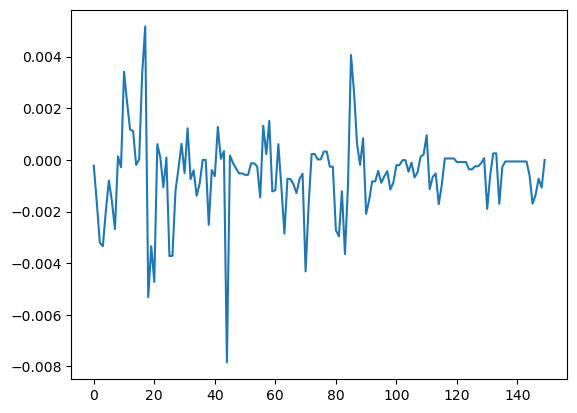



----> END 19:40:23 (took 0:02:34.158431).


In [8]:
loop_over_samples(7, 14)